# Importing Required Libraries :

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
import sklearn
import warnings
warnings.filterwarnings('ignore')

# Importing Dataset :

In [2]:
df=pd.read_csv("Rainfall_Weather_Forecasting.csv")
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


The dataset contains both dependent and independent varaibles and also contains both categorical and numerical data.In this dataset "RainTomorrow" is our 1st target variable which has two classes.So this is a "Classification type" problem and "Rainfall" is 2nd target variable so regression probelm also.


# Exploratory Data Analysis(EDA)

In [3]:
# Checking No of Rows and columns :
    
df.shape  

(8425, 23)

In [4]:
# First 5 rows of dataset :
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [5]:
# Last 5 rows of dataset :
df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [6]:
# Checking columns name:

df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [7]:
# Checking datatypes of all columns :

df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [8]:
# checking info of data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

It gives the information about the dataset which includes indexing type, column type, null values and memory usage.

In [9]:
# Checking unique values in each column

df.nunique()

Date             3004
Location           12
MinTemp           285
MaxTemp           331
Rainfall          250
Evaporation       116
Sunshine          140
WindGustDir        16
WindGustSpeed      52
WindDir9am         16
WindDir3pm         16
WindSpeed9am       34
WindSpeed3pm       35
Humidity9am        90
Humidity3pm        94
Pressure9am       384
Pressure3pm       374
Cloud9am            9
Cloud3pm            9
Temp9am           304
Temp3pm           328
RainToday           2
RainTomorrow        2
dtype: int64

These are the number of unique values present in each columns.

In [10]:
# Checking Missing values in dataset :

df.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

Now we fill categorical values with mode and continuous values with mean/median

In [11]:
# filling null values with median in numerical columns

df.fillna(df.median(), inplace=True)

In [12]:
# Checking again null values :

df.isnull().sum()

Date               0
Location           0
MinTemp            0
MaxTemp            0
Rainfall           0
Evaporation        0
Sunshine           0
WindGustDir      991
WindGustSpeed      0
WindDir9am       829
WindDir3pm       308
WindSpeed9am       0
WindSpeed3pm       0
Humidity9am        0
Humidity3pm        0
Pressure9am        0
Pressure3pm        0
Cloud9am           0
Cloud3pm           0
Temp9am            0
Temp3pm            0
RainToday        240
RainTomorrow     239
dtype: int64

In [13]:
df['WindGustDir'].fillna(df['WindGustDir'].mode()[0], inplace=True)
df['WindDir9am'].fillna(df['WindDir9am'].mode()[0], inplace=True)
df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0], inplace=True)
df['RainToday'].fillna(df['RainToday'].mode()[0], inplace=True)
df['RainTomorrow'].fillna(df['RainTomorrow'].mode()[0], inplace=True)

In [14]:
df.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

Now there are no null values as we treated null values.

# Heatmap of null values

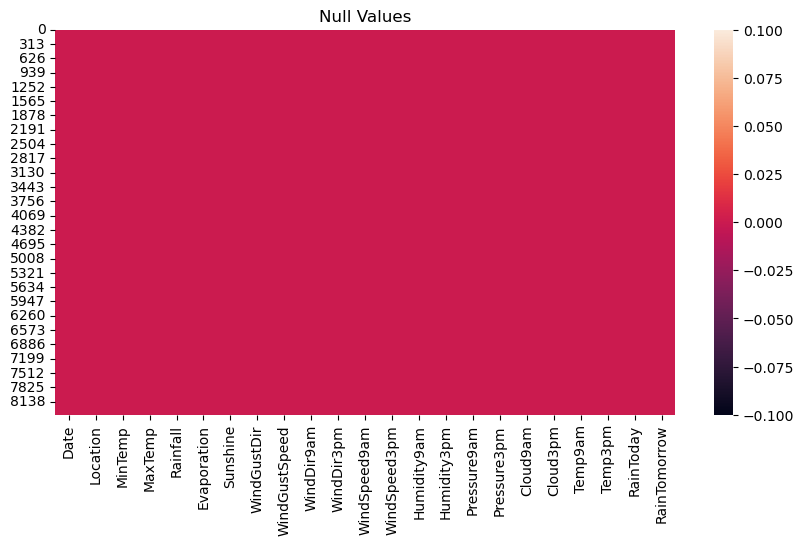

In [15]:
# lets visualize the null values clearly

plt.figure(figsize=[10,5])
sns.heatmap(df.isnull())
plt.title('Null Values')
plt.show()

In [16]:
# checking the uniqueness of Target Variable :

df['RainTomorrow'].unique()

array(['No', 'Yes'], dtype=object)

There are 2 unique values in target variable.

In [17]:
df['RainTomorrow'].value_counts()

No     6434
Yes    1991
Name: RainTomorrow, dtype: int64

We need to do undersampling or oversampling later to make counts equal of target varaible.

In [18]:
df['Rainfall'].unique()

array([6.000e-01, 0.000e+00, 1.000e+00, 2.000e-01, 1.400e+00, 2.200e+00,
       1.560e+01, 3.600e+00, 1.680e+01, 1.060e+01, 1.200e+00, 8.000e-01,
       6.400e+00, 4.000e-01, 3.000e+00, 5.800e+00, 1.160e+01, 1.800e+00,
       8.600e+00, 1.260e+01, 8.400e+00, 6.200e+00, 2.000e+01, 2.100e+01,
       3.200e+00, 4.800e+00, 4.200e+00, 8.000e+00, 1.440e+01, 4.600e+00,
       2.000e+00, 5.600e+00, 1.600e+00, 6.000e+00, 4.400e+00, 5.400e+00,
       5.000e+00, 7.800e+00, 6.800e+00, 9.800e+00, 3.800e+00, 2.400e+00,
       5.200e+00, 6.600e+00, 1.340e+01, 1.020e+01, 2.880e+01, 7.000e+00,
       2.580e+01, 9.400e+00, 1.240e+01, 5.220e+01, 2.060e+01, 6.600e+01,
       1.100e+01, 1.700e+01, 1.040e+01, 2.800e+01, 2.140e+01, 1.860e+01,
       7.200e+00, 8.200e+00, 1.080e+01, 1.540e+01, 9.600e+00, 4.000e+00,
       2.180e+01, 2.080e+01, 2.480e+01, 1.000e+01, 1.140e+01, 1.900e+01,
       2.220e+01, 3.280e+01, 3.400e+00, 5.080e+01, 5.260e+01, 1.920e+01,
       1.880e+01, 1.480e+01, 1.200e+01, 1.840e+01, 

In [19]:
# checking whether the dataset contains any space

df.loc[df['RainTomorrow']==" "]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow


In [20]:
# checking whether the dataset contains any space

df.loc[df['Rainfall']==" "]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow


It seems that there are no spaces in the dataset.

# Data Analysis and Visulization

Statistical measure of dataset :

In [21]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.194255,23.855988,2.725982,5.060332,8.138409,40.036320,13.840000,18.539585,67.823739,51.246766,1017.649519,1015.246030,4.691157,4.647953,17.762267,22.436748
std,5.379497,6.114697,10.319872,3.871619,2.875324,13.781296,10.128896,9.704899,16.774237,18.311914,6.275796,6.217494,2.437110,2.310476,5.608301,5.946128
min,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000
25%,9.300000,19.300000,0.000000,4.000000,8.400000,31.000000,6.000000,11.000000,56.000000,39.000000,1014.000000,1011.400000,3.000000,3.000000,13.800000,18.100000
50%,13.300000,23.300000,0.000000,4.600000,8.700000,39.000000,13.000000,19.000000,68.000000,51.000000,1017.700000,1015.300000,5.000000,5.000000,17.800000,21.900000
75%,17.300000,28.000000,0.800000,5.200000,8.900000,48.000000,20.000000,24.000000,80.000000,63.000000,1021.300000,1018.800000,7.000000,7.000000,21.900000,26.300000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000


All statistical data of all rows shown for each parameters like mean, minimum, maximum , 25th percentile means how much value for each column are below 25th percentile ,similarly for 50th perecntile and 75th perecntile.


In [22]:
#want to describe along categorical data

df.describe(include=['O'])

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
count,8425,8425,8425,8425,8425,8425,8425
unique,3004,12,16,16,16,2,2
top,2011-01-31,Melbourne,N,N,SE,No,No
freq,5,1622,1704,1735,1121,6435,6434


# Finding Columns as (Categorical) V/S (Numerical) Columns

In [23]:
# Separating categorical columns :

categorical_columns=[]

for i in df.dtypes.index:
    if df.dtypes[i]=='object':
        categorical_columns.append(i)
print(categorical_columns)

['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


Here, we found out list of categorical columns.

In [24]:
# Separating numerical columns:

numerical_columns=[]

for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        numerical_columns.append(i)
print(numerical_columns)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


Here, we found out list of numerical columns.

In [25]:
## as Date is of no relevance so drop this

df.drop(['Date'],axis=1,inplace=True)

# Data Visualization

Univariate Analysis

In [26]:
## Plotting Count Plot for categorical columns 

Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64


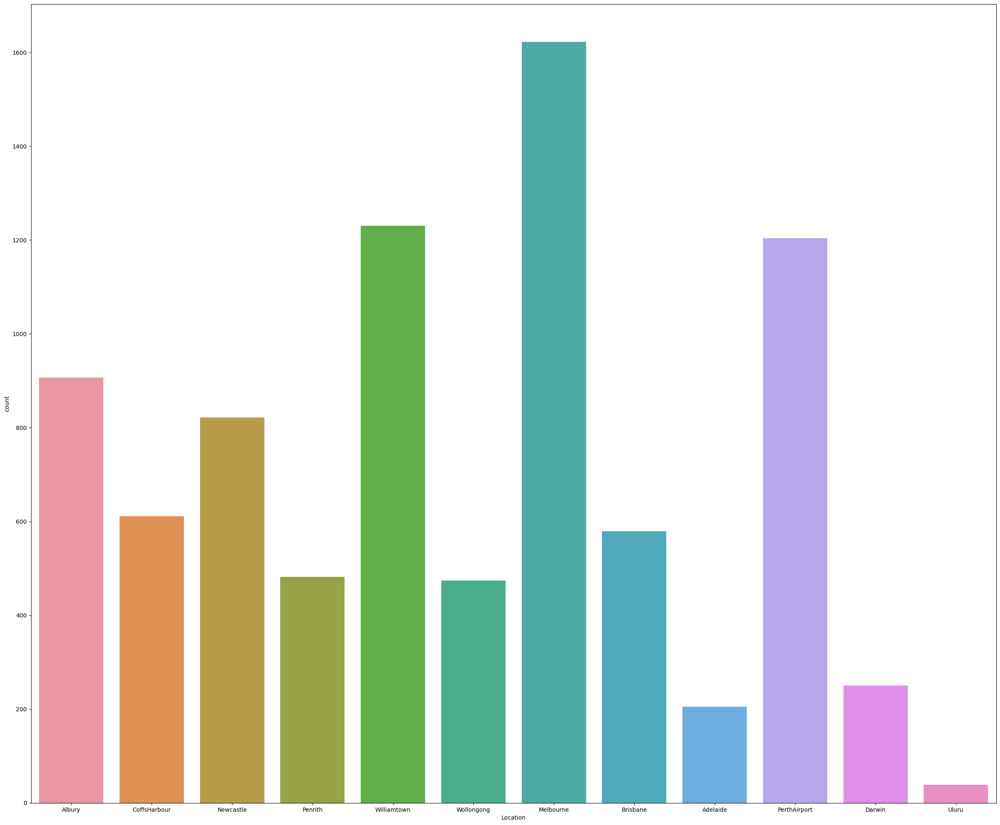

In [28]:
# # visualizing the Location

print(df["Location"].value_counts())
plt.figure(figsize=(30,25))
sns.countplot(x="Location",data=df)
plt.show()

In Melbourne higher possibility of rain.

N      1704
SSE     578
S       577
SW      572
E       557
WNW     531
W       507
WSW     504
SE      484
ENE     415
SSW     396
NW      383
NE      353
NNE     343
ESE     302
NNW     219
Name: WindGustDir, dtype: int64


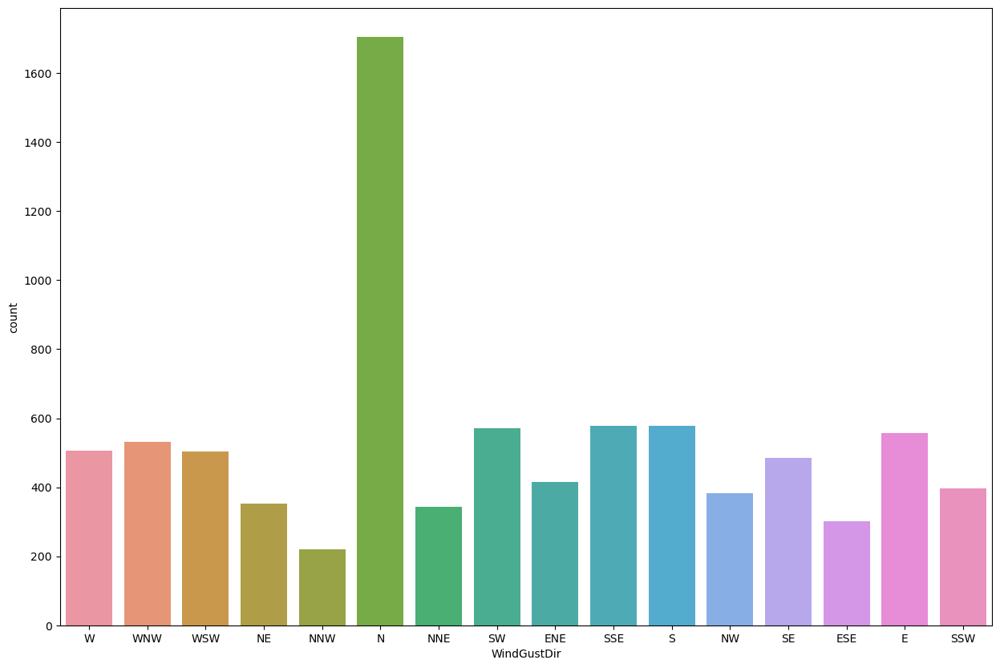

In [30]:
# # visualizing the WindGustDir

print(df["WindGustDir"].value_counts())
plt.figure(figsize=(15,10))
sns.countplot(x="WindGustDir",data=df)
plt.show()

In north, highr chances of raining

No     6435
Yes    1990
Name: RainToday, dtype: int64


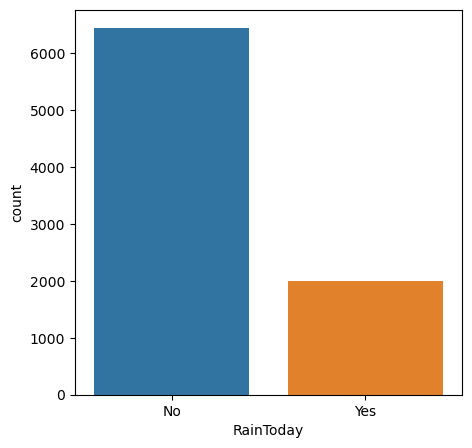

In [31]:
# # visualizing the RainToday

print(df["RainToday"].value_counts())
plt.figure(figsize=(5,5))
sns.countplot(x="RainToday",data=df)
plt.show()

highr chances of not raining today.

No     6434
Yes    1991
Name: RainTomorrow, dtype: int64


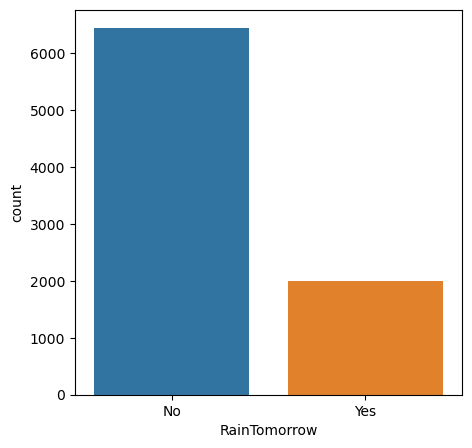

In [32]:
# # visualizing the RainTomorrow

print(df["RainTomorrow"].value_counts())
plt.figure(figsize=(5,5))
sns.countplot(x="RainTomorrow",data=df)
plt.show()

Highr chances of not raining tomorrow.

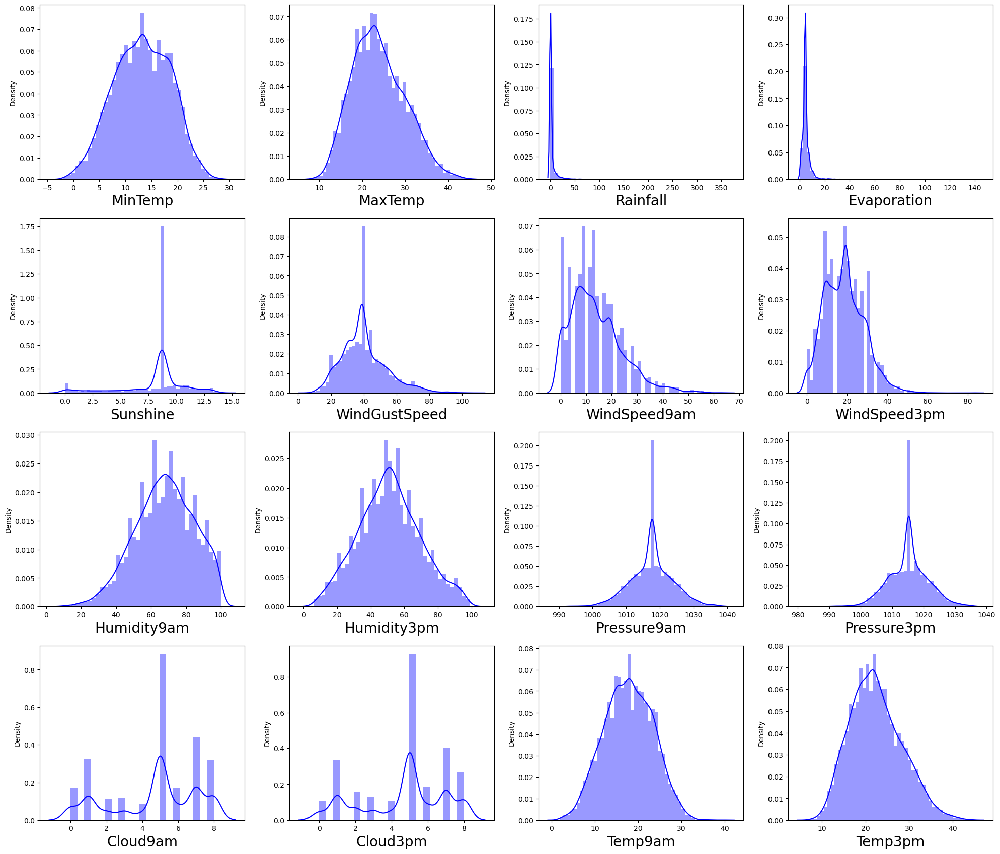

In [34]:
# checking how the data has been distributed in each column

plt.figure(figsize=(20,25))
plotnumber=1
for column in numerical_columns:
    if plotnumber<=16:
        ax=plt.subplot(6,4,plotnumber)
        sns.distplot(df[column],color="blue")
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.tight_layout()

There is skewness in cloud9am, cloud3pm, sunshine, rainfall evaporation .

# Bivariate Analysis

<Axes: xlabel='RainTomorrow', ylabel='MinTemp'>

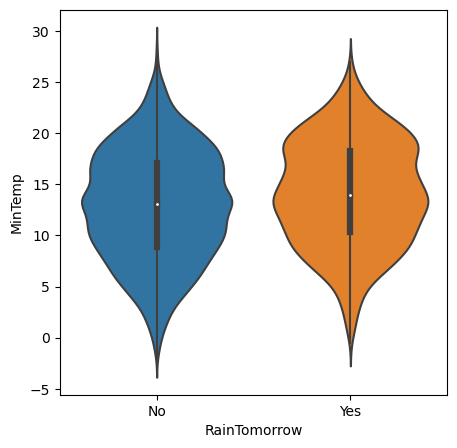

In [36]:
# Checking RainTomorrow and MinTemp
plt.figure(figsize=(5,5))
sns.violinplot(x='RainTomorrow',y='MinTemp',data=df)

Higher chances of not raining at mintemp 30

<Axes: xlabel='RainTomorrow', ylabel='MaxTemp'>

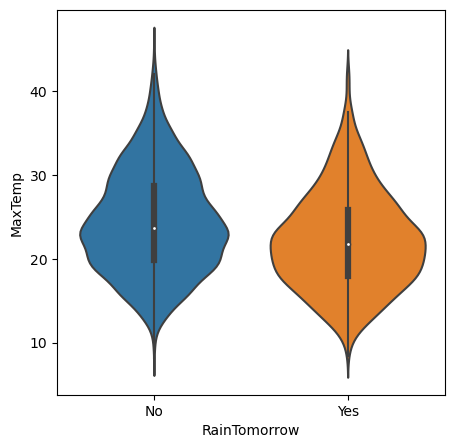

In [37]:
# Checking RainTomorrow and MaxTemp
plt.figure(figsize=(5,5))
sns.violinplot(x='RainTomorrow',y='MaxTemp',data=df)

Higher chances of not raining at mintemp 40+

<Axes: xlabel='RainTomorrow', ylabel='Cloud9am'>

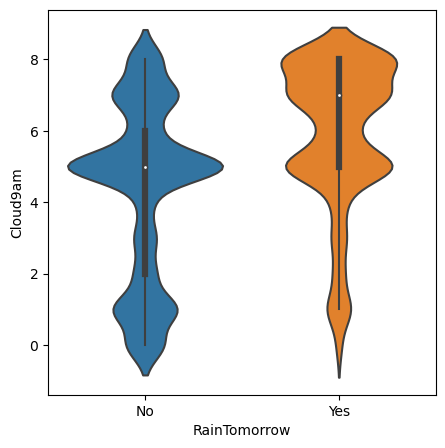

In [41]:
# Checking RainTomorrow and cloud9am
plt.figure(figsize=(5,5))
sns.violinplot(x='RainTomorrow',y='Cloud9am',data=df)

It have similar data in both cases

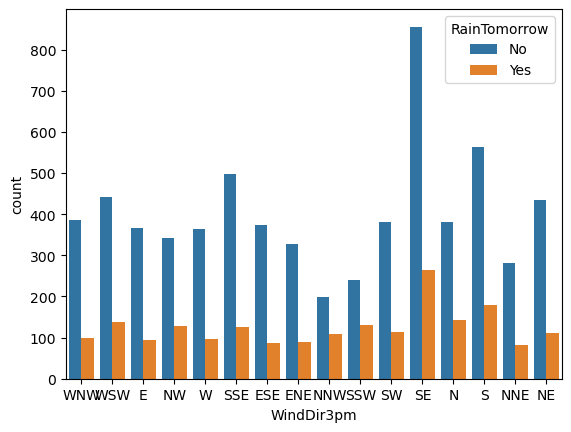

In [42]:
#Visualizing count of WindDir3pm on the basis of rainTomorrow
sns.countplot(x='WindDir3pm',hue='RainTomorrow',data=df)
plt.show()


High chanches of raining in SE direction

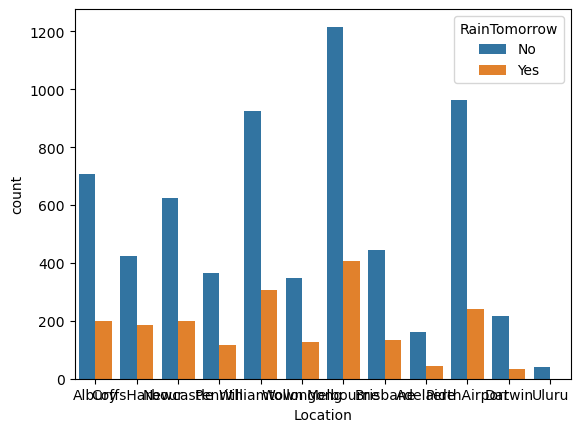

In [43]:
#Visualizing count of Location on the basis of rainTomorrow
sns.countplot(x='Location',hue='RainTomorrow',data=df)
plt.show()


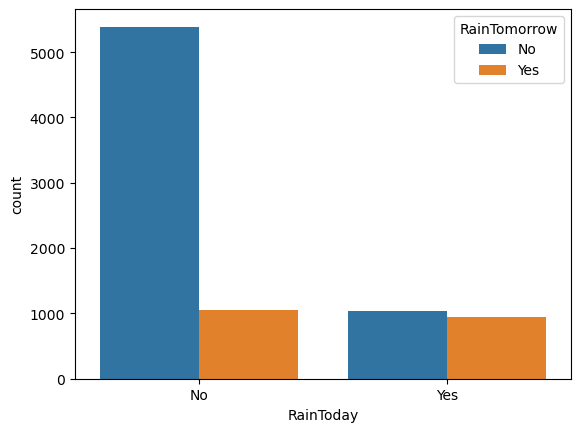

In [45]:
#Visualizing count of rainToday on the basis of rainTomorrow
sns.countplot(x='RainToday',hue='RainTomorrow',data=df)
plt.show()


Not raining today count is high and similar in raining today

# Multivariate Analysis:

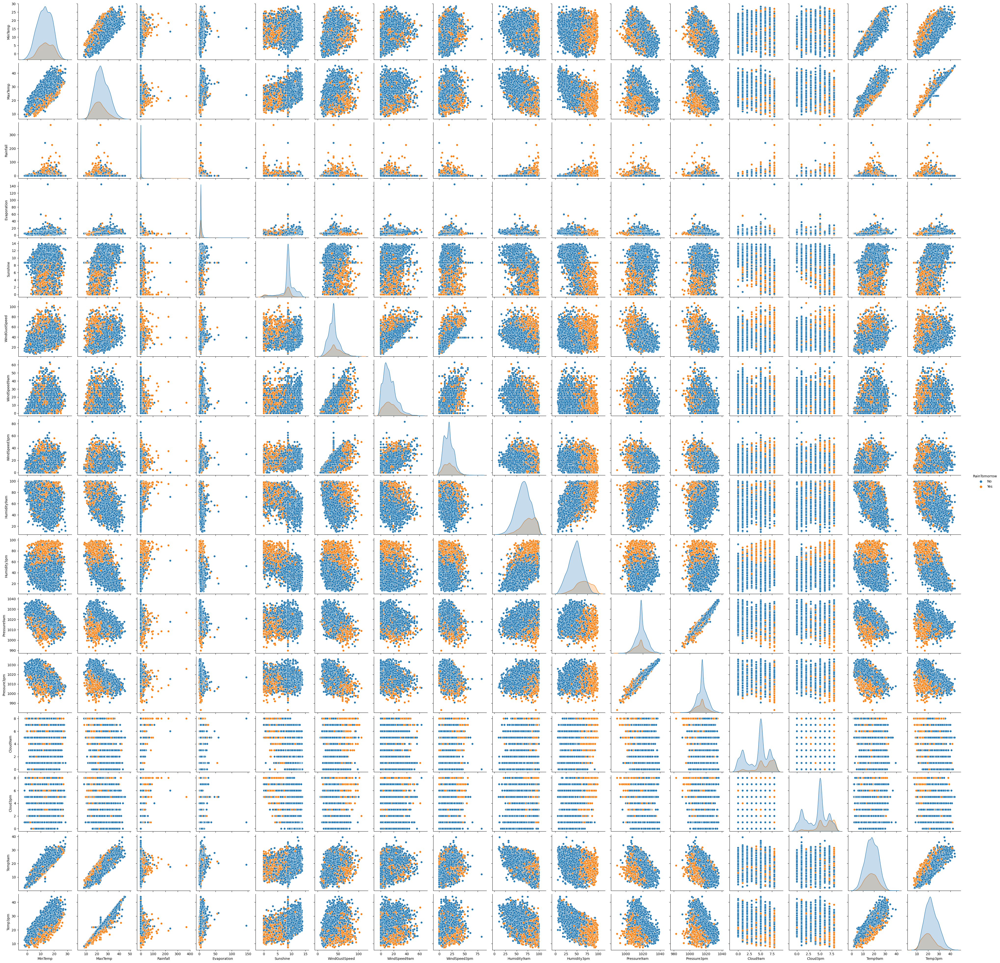

In [46]:
# Checking the pairwise relation in the dataset.
sns.pairplot(df,hue='RainTomorrow')

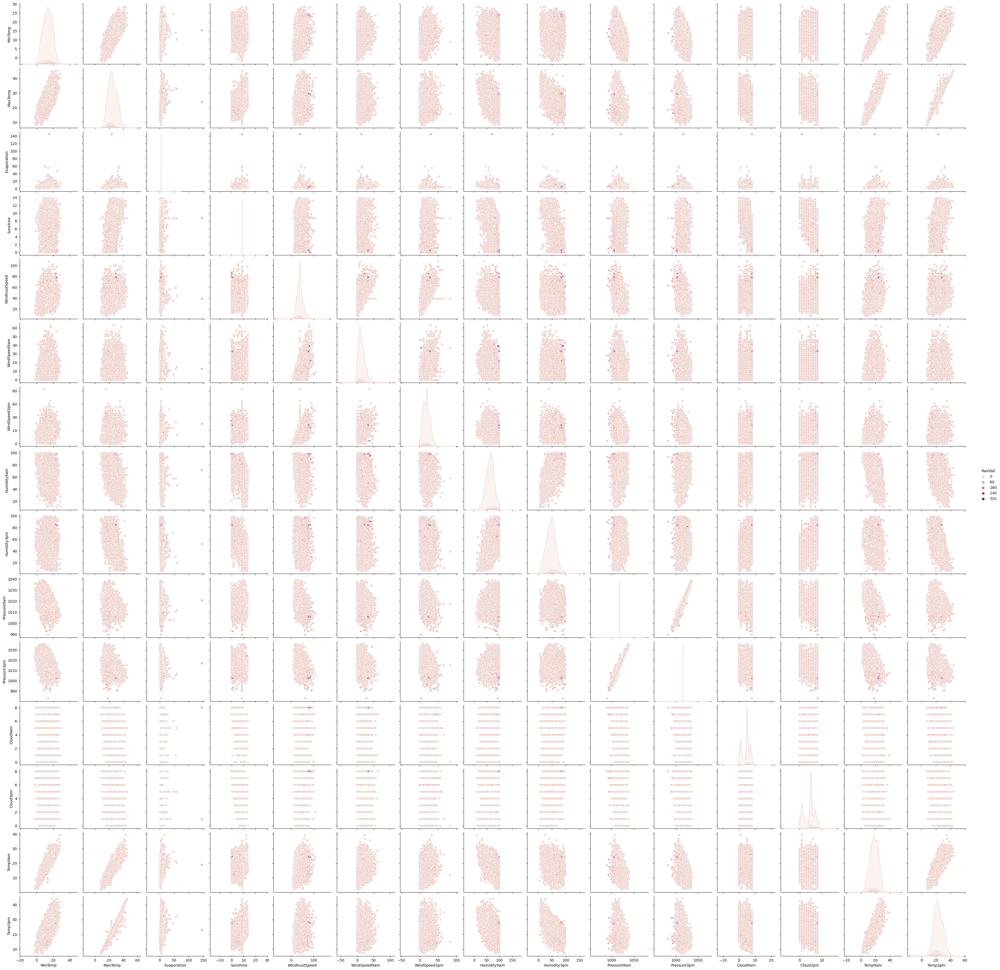

In [47]:
# Checking the pairwise relation in the dataset.
sns.pairplot(df,hue='Rainfall')

We can observe the correlation in some columns also there are outliers present in some of the columns.

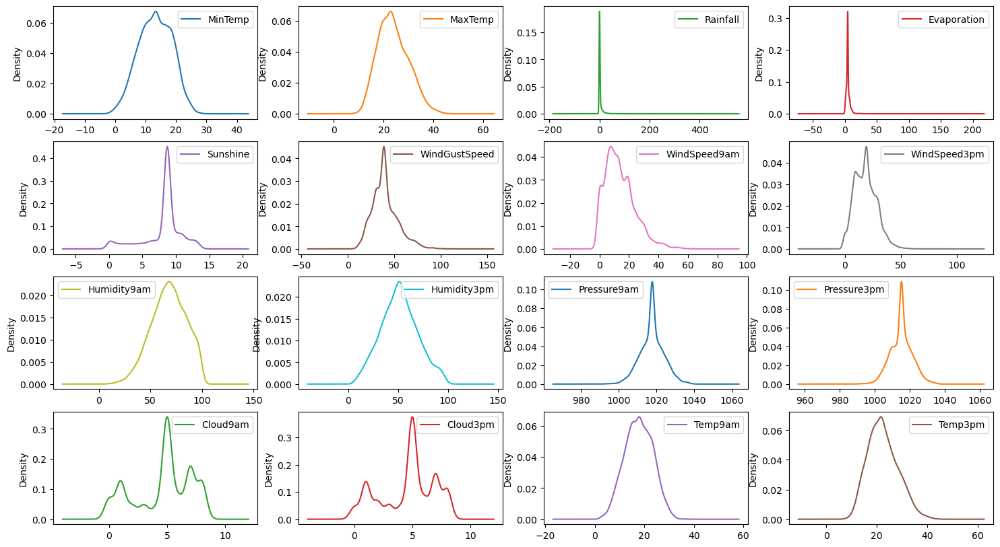

In [49]:
#check data distribution among all coulmns

df.plot(kind='density',subplots=True,layout=(4,4),sharex=False,legend=True,figsize=(18,10))
plt.show()

#Observation : We can see skewness is present in data

# Identifying the outliers:

<Axes: >

<Figure size 2500x2200 with 0 Axes>

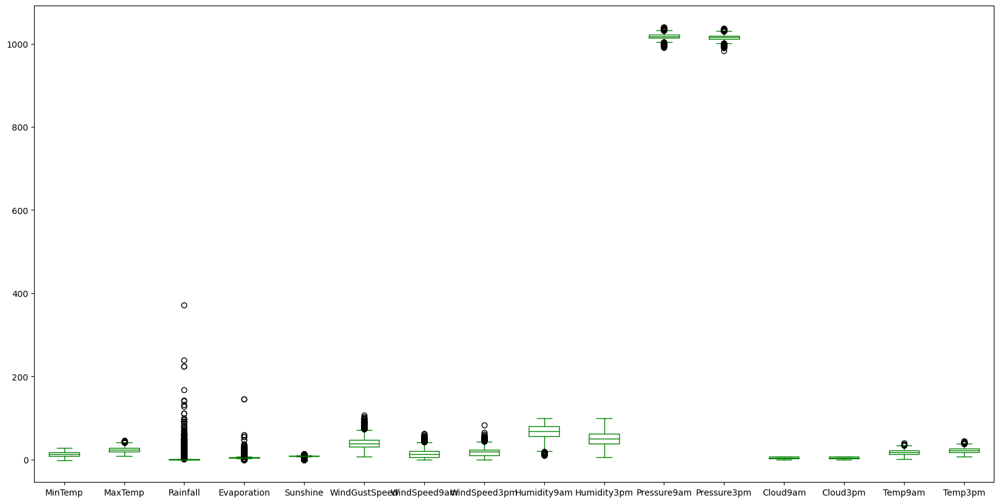

In [50]:
plt.figure(figsize=(25,22))
df.plot(kind='box',fontsize=10,figsize=(20,10),color='g')

We will treat columns as outlier present

# Removing Outliers :

In [52]:
# Zscore method:

#Features having outliers
features = df[['MaxTemp','Rainfall','Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Pressure9am','Pressure3pm','Temp9am','Temp3pm']]

In [53]:
from scipy.stats import zscore
z=np.abs(zscore(features))
df_new=df[(z<3).all(axis=1)]
df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,Albury,13.4,22.9,0.6,4.6,8.7,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,No,No
1,Albury,7.4,25.1,0.0,4.6,8.7,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,No,No
2,Albury,12.9,25.7,0.0,4.6,8.7,WSW,46.0,W,WSW,...,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,No,No
3,Albury,9.2,28.0,0.0,4.6,8.7,NE,24.0,SE,E,...,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,No,No
4,Albury,17.5,32.3,1.0,4.6,8.7,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.4,0.0,4.6,8.7,E,31.0,SE,ENE,...,51.0,24.0,1024.6,1020.3,5.0,5.0,10.1,22.4,No,No
8421,Uluru,3.6,25.3,0.0,4.6,8.7,NNW,22.0,SE,N,...,56.0,21.0,1023.5,1019.1,5.0,5.0,10.9,24.5,No,No
8422,Uluru,5.4,26.9,0.0,4.6,8.7,N,37.0,SE,WNW,...,53.0,24.0,1021.0,1016.8,5.0,5.0,12.5,26.1,No,No
8423,Uluru,7.8,27.0,0.0,4.6,8.7,SE,28.0,SSE,N,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


This is the new dataframe after removing the outliers. Here we have removed the outliers whose Zscore is less than 3.

In [54]:
# Shape of original dataset

df.shape

(8425, 22)

Before removing the outliers we had 8425 rows and 22 columns in our dataset.

In [55]:
# Shape of new dataframe

df_new.shape

(7998, 22)

Now we had 7998 rows and 22 columns in our dataset.

In [56]:
# Checking the the data loss
data_loss = (8425-7998)/8425*100
data_loss

5.068249258160237

I can see dataloss in zscore method after removing outliers of 5.0% which is less than 10%. So we check Skewness now.

# Encoding Categorical columns

In [57]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
for i in df_new.columns:
    if df_new[i].dtypes=="object":
        df_new[i]=le.fit_transform(df_new[i].values.reshape(-1,1))
df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,1,13.4,22.9,0.6,4.6,8.7,13,44.0,13,14,...,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,0,0
1,1,7.4,25.1,0.0,4.6,8.7,14,44.0,6,15,...,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0,0
2,1,12.9,25.7,0.0,4.6,8.7,15,46.0,13,15,...,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0,0
3,1,9.2,28.0,0.0,4.6,8.7,4,24.0,9,0,...,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,0,0
4,1,17.5,32.3,1.0,4.6,8.7,13,41.0,1,7,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,0.0,4.6,8.7,0,31.0,9,1,...,51.0,24.0,1024.6,1020.3,5.0,5.0,10.1,22.4,0,0
8421,9,3.6,25.3,0.0,4.6,8.7,6,22.0,9,3,...,56.0,21.0,1023.5,1019.1,5.0,5.0,10.9,24.5,0,0
8422,9,5.4,26.9,0.0,4.6,8.7,3,37.0,9,14,...,53.0,24.0,1021.0,1016.8,5.0,5.0,12.5,26.1,0,0
8423,9,7.8,27.0,0.0,4.6,8.7,9,28.0,10,3,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,0,0


# Correlation :

In [58]:
#Now we check correlation of input parameters with output "quality" :
#positively correlated : direct correlation
#negatively correlated : negative correlation

In [59]:
dfcor=df_new.corr()
dfcor

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Location,1.000000,0.115241,0.062409,0.018149,0.110544,0.077990,-0.037249,0.243807,-0.040488,-0.031523,...,0.005639,0.061040,-0.023416,-0.011635,0.040822,0.024791,0.116568,0.058951,0.003259,0.009539
MinTemp,0.115241,1.000000,0.718253,0.088414,0.391006,0.040074,-0.155364,0.231589,-0.046154,-0.152830,...,-0.129246,0.087599,-0.433734,-0.428562,0.075396,0.019804,0.887798,0.687892,0.060968,0.090304
MaxTemp,0.062409,0.718253,1.000000,-0.139024,0.482253,0.366175,-0.236928,0.137015,-0.217723,-0.187830,...,-0.387835,-0.412873,-0.334065,-0.414861,-0.255029,-0.251769,0.865611,0.975116,-0.220366,-0.150514
Rainfall,0.018149,0.088414,-0.139024,1.000000,-0.094926,-0.159253,0.081222,0.087701,0.121855,0.074087,...,0.293815,0.289134,-0.098008,-0.038606,0.211458,0.176940,-0.034516,-0.147116,0.697599,0.268179
Evaporation,0.110544,0.391006,0.482253,-0.094926,1.000000,0.358110,-0.112323,0.221985,-0.103853,-0.034506,...,-0.368468,-0.249362,-0.263466,-0.277860,-0.145597,-0.169909,0.465380,0.465432,-0.166564,-0.092444
Sunshine,0.077990,0.040074,0.366175,-0.159253,0.358110,1.000000,-0.106703,-0.011822,-0.086290,-0.065272,...,-0.320044,-0.417898,0.000347,-0.059407,-0.483318,-0.505834,0.230668,0.385085,-0.214537,-0.311186
WindGustDir,-0.037249,-0.155364,-0.236928,0.081222,-0.112323,-0.106703,1.000000,0.015201,0.405510,0.506883,...,0.031415,0.051925,-0.096228,-0.009530,0.132672,0.102701,-0.184746,-0.248919,0.121727,0.044461
WindGustSpeed,0.243807,0.231589,0.137015,0.087701,0.221985,-0.011822,0.015201,1.000000,-0.065799,0.076568,...,-0.266783,-0.087970,-0.377698,-0.336537,0.008514,0.053545,0.199697,0.102335,0.076549,0.181238
WindDir9am,-0.040488,-0.046154,-0.217723,0.121855,-0.103853,-0.086290,0.405510,-0.065799,1.000000,0.242675,...,0.012115,0.119225,-0.003919,0.081347,0.093727,0.064353,-0.102967,-0.224668,0.149614,0.027524
WindDir3pm,-0.031523,-0.152830,-0.187830,0.074087,-0.034506,-0.065272,0.506883,0.076568,0.242675,1.000000,...,-0.011225,-0.011131,-0.130461,-0.038002,0.075878,0.055824,-0.169138,-0.200093,0.100297,0.003100


<Axes: >

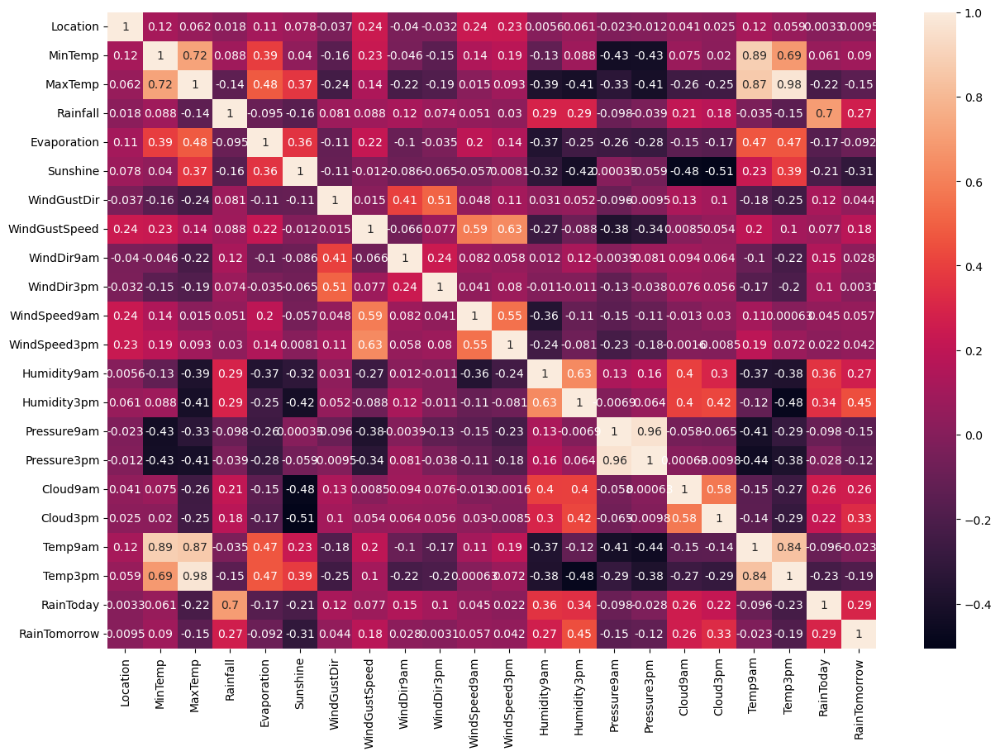

In [60]:
# For better understanding of correlation matrix between columns we draw heatmap :

plt.figure(figsize=(15,10))
sns.heatmap(dfcor,annot=True)

<Axes: >

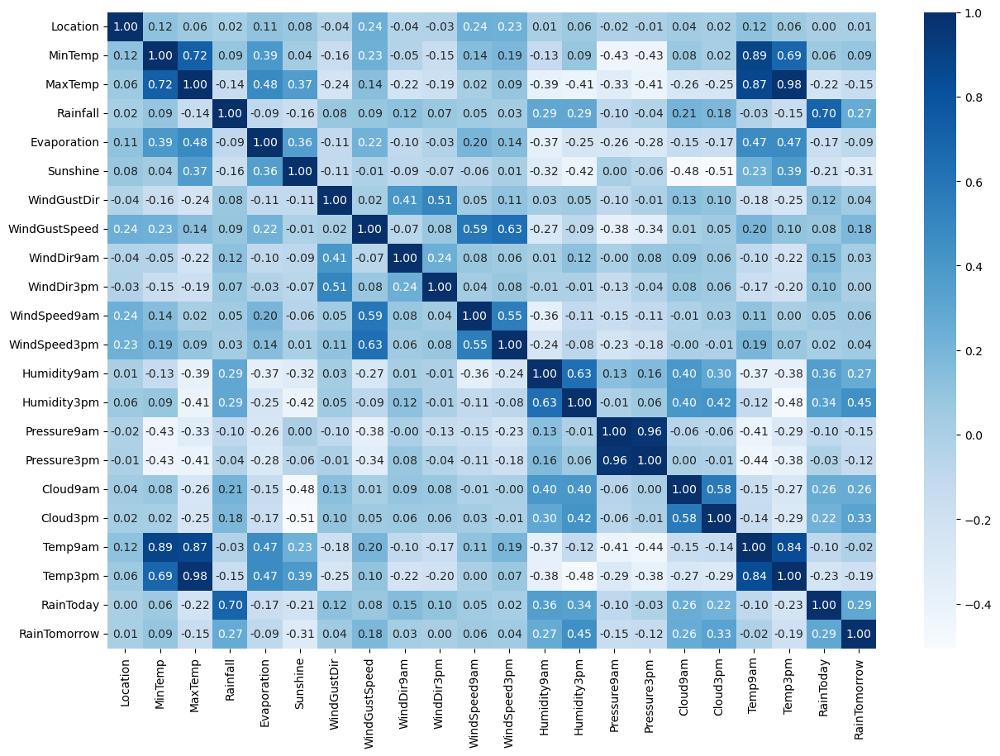

In [61]:
# We can change color also and decimal values place :

plt.figure(figsize=(15,10))
sns.heatmap(dfcor,annot=True,cmap='Blues',fmt='0.2f',cbar=True,square=False)

In [62]:
#Correlation of all columns with the target column 'Churn':

df_new.corr()['RainTomorrow'].sort_values()

Sunshine        -0.311186
Temp3pm         -0.192380
Pressure9am     -0.152094
MaxTemp         -0.150514
Pressure3pm     -0.124308
Evaporation     -0.092444
Temp9am         -0.022902
WindDir3pm       0.003100
Location         0.009539
WindDir9am       0.027524
WindSpeed3pm     0.042239
WindGustDir      0.044461
WindSpeed9am     0.057066
MinTemp          0.090304
WindGustSpeed    0.181238
Cloud9am         0.262304
Rainfall         0.268179
Humidity9am      0.270125
RainToday        0.294814
Cloud3pm         0.326060
Humidity3pm      0.445965
RainTomorrow     1.000000
Name: RainTomorrow, dtype: float64

In [63]:
#Correlation of all columns with the target column 'Churn':

df_new.corr()['Rainfall'].sort_values()

Sunshine        -0.159253
Temp3pm         -0.147116
MaxTemp         -0.139024
Pressure9am     -0.098008
Evaporation     -0.094926
Pressure3pm     -0.038606
Temp9am         -0.034516
Location         0.018149
WindSpeed3pm     0.030234
WindSpeed9am     0.051071
WindDir3pm       0.074087
WindGustDir      0.081222
WindGustSpeed    0.087701
MinTemp          0.088414
WindDir9am       0.121855
Cloud3pm         0.176940
Cloud9am         0.211458
RainTomorrow     0.268179
Humidity3pm      0.289134
Humidity9am      0.293815
RainToday        0.697599
Rainfall         1.000000
Name: Rainfall, dtype: float64

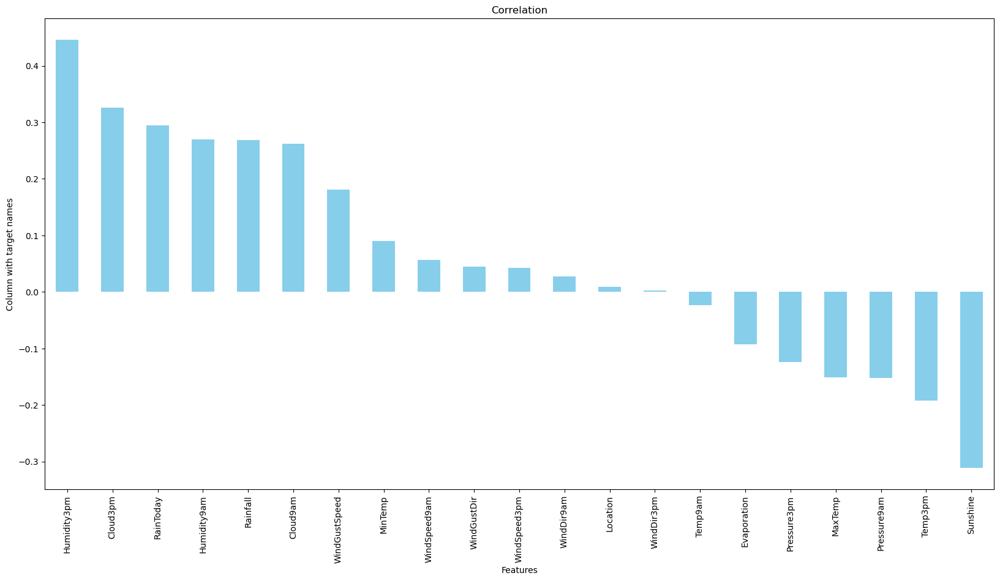

In [64]:
plt.figure(figsize =(20,10))
df_new.corr()['RainTomorrow'].sort_values(ascending = False).drop(['RainTomorrow']).plot(kind ='bar', color ='skyblue')
plt.xlabel('Features')
plt.ylabel('Column with target names')
plt.title('Correlation')
plt.show()

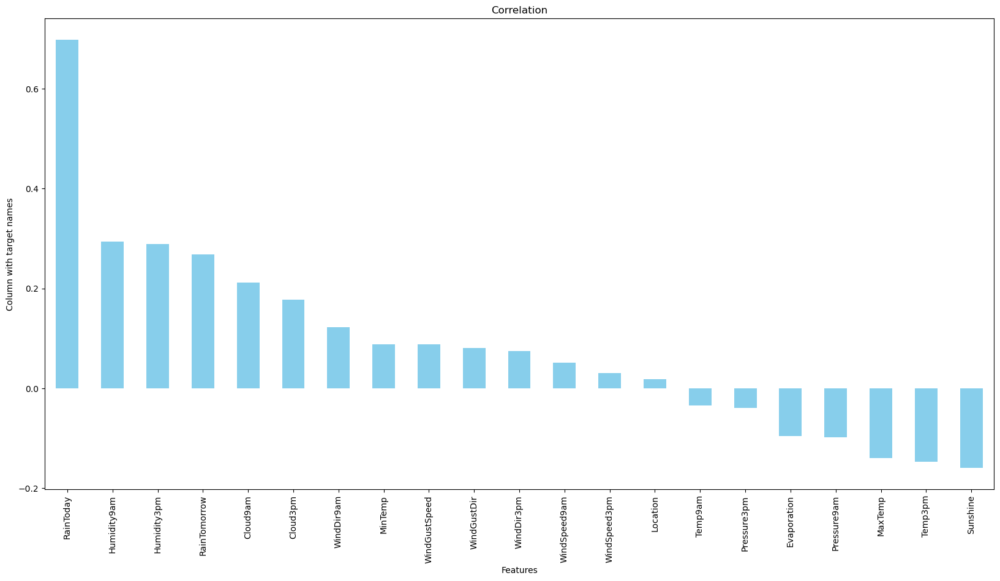

In [65]:
plt.figure(figsize =(20,10))
df_new.corr()['Rainfall'].sort_values(ascending = False).drop(['Rainfall']).plot(kind ='bar', color ='skyblue')
plt.xlabel('Features')
plt.ylabel('Column with target names')
plt.title('Correlation')
plt.show()

There is no need of data drop so we move further.

# Data Preprocessing :

# 1) RainTomorrow

Splitting the columns :

In [67]:
x=df_new.drop('RainTomorrow', axis=1)
y=df_new['RainTomorrow']

In [68]:
x

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,1,13.4,22.9,0.6,4.6,8.7,13,44.0,13,14,...,24.0,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,0
1,1,7.4,25.1,0.0,4.6,8.7,14,44.0,6,15,...,22.0,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0
2,1,12.9,25.7,0.0,4.6,8.7,15,46.0,13,15,...,26.0,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0
3,1,9.2,28.0,0.0,4.6,8.7,4,24.0,9,0,...,9.0,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,0
4,1,17.5,32.3,1.0,4.6,8.7,13,41.0,1,7,...,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,0.0,4.6,8.7,0,31.0,9,1,...,11.0,51.0,24.0,1024.6,1020.3,5.0,5.0,10.1,22.4,0
8421,9,3.6,25.3,0.0,4.6,8.7,6,22.0,9,3,...,9.0,56.0,21.0,1023.5,1019.1,5.0,5.0,10.9,24.5,0
8422,9,5.4,26.9,0.0,4.6,8.7,3,37.0,9,14,...,9.0,53.0,24.0,1021.0,1016.8,5.0,5.0,12.5,26.1,0
8423,9,7.8,27.0,0.0,4.6,8.7,9,28.0,10,3,...,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,0


# Handling Imbalance Data :

In [69]:
# Oversampling

from imblearn.over_sampling import SMOTE
SM=SMOTE()
x,y=SM.fit_resample(x,y)
y.value_counts()  

0    6176
1    6176
Name: RainTomorrow, dtype: int64

# Check skewness

In [70]:
x.skew().sort_values(ascending=False)

Rainfall         2.847973
Evaporation      1.308774
RainToday        1.063804
WindSpeed9am     0.635858
WindGustSpeed    0.494357
Temp3pm          0.386745
MaxTemp          0.355074
WindSpeed3pm     0.236442
WindDir9am       0.171682
WindGustDir      0.107602
Pressure3pm      0.089032
Pressure9am      0.055939
Temp9am         -0.001935
Location        -0.022606
Humidity3pm     -0.031896
MinTemp         -0.103163
WindDir3pm      -0.118260
Humidity9am     -0.417530
Cloud3pm        -0.681467
Cloud9am        -0.703460
Sunshine        -1.026209
dtype: float64

*Observation : Some skewness present in some parameters so we apply Transformation.

In [71]:
#Remove Skewness - apply power transformation

from sklearn.preprocessing import power_transform
x_new=power_transform(x,method='yeo-johnson')
x_new

array([[-1.60581555e+00, -2.71379226e-03,  3.33400783e-02, ...,
        -1.16678049e-01,  1.08319150e-01, -6.00792777e-01],
       [-1.60581555e+00, -1.15101035e+00,  4.00048284e-01, ...,
        -6.11089988e-02,  5.27607960e-01, -6.00792777e-01],
       [-1.60581555e+00, -9.85441759e-02,  4.96629731e-01, ...,
         6.37914161e-01,  3.46556107e-01, -6.00792777e-01],
       ...,
       [ 1.28073161e-01, -5.12659077e-01, -8.40906342e-01, ...,
        -3.75371642e-01, -8.80259574e-01,  1.66446741e+00],
       [ 1.34107351e+00,  1.01597406e+00, -2.34786621e-05, ...,
         5.44696119e-01,  1.43056368e-01,  1.66446741e+00],
       [-1.92818930e-01, -1.49460167e+00, -1.72196684e+00, ...,
        -1.72196035e+00, -1.47509878e+00,  1.66446741e+00]])

In [72]:
x=pd.DataFrame(x_new,columns=x.columns)                                        #convert transformed data into DataFrame

In [73]:
x.skew().sort_values(ascending=False)

RainToday        1.063804
Rainfall         0.664472
Evaporation      0.064318
Pressure3pm      0.000000
WindGustSpeed   -0.000284
Pressure9am     -0.000896
Temp3pm         -0.010740
MaxTemp         -0.011647
Temp9am         -0.048876
Humidity3pm     -0.063379
WindSpeed3pm    -0.095388
Humidity9am     -0.096998
MinTemp         -0.097256
WindSpeed9am    -0.114885
WindDir9am      -0.143986
Location        -0.168331
WindGustDir     -0.178790
WindDir3pm      -0.233124
Sunshine        -0.292736
Cloud3pm        -0.302067
Cloud9am        -0.353739
dtype: float64

I have removed the skewness using yeo-johnson method. The skewness has been removed in all the numerical integer type columns.

# Feature Scaling :

In [74]:
# Scaling increases the model performance to much extent, we get best result after scaling data

# Standard Scaling :

from sklearn.preprocessing import StandardScaler
st=StandardScaler()
x1=st.fit_transform(x)
x1

array([[-1.60581555e+00, -2.71379226e-03,  3.33400783e-02, ...,
        -1.16678049e-01,  1.08319150e-01, -6.00792777e-01],
       [-1.60581555e+00, -1.15101035e+00,  4.00048284e-01, ...,
        -6.11089988e-02,  5.27607960e-01, -6.00792777e-01],
       [-1.60581555e+00, -9.85441759e-02,  4.96629731e-01, ...,
         6.37914161e-01,  3.46556107e-01, -6.00792777e-01],
       ...,
       [ 1.28073161e-01, -5.12659077e-01, -8.40906342e-01, ...,
        -3.75371642e-01, -8.80259574e-01,  1.66446741e+00],
       [ 1.34107351e+00,  1.01597406e+00, -2.34786621e-05, ...,
         5.44696119e-01,  1.43056368e-01,  1.66446741e+00],
       [-1.92818930e-01, -1.49460167e+00, -1.72196684e+00, ...,
        -1.72196035e+00, -1.47509878e+00,  1.66446741e+00]])

In [75]:
x=pd.DataFrame(x1,columns=x.columns)                                   #convert scaled data into DataFrame

In [76]:
# Multicollinearity Check VIF Technique

from statsmodels.stats.outliers_influence import variance_inflation_factor

In [77]:
def vif_calc():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
    
vif_calc()

    VIF Factor       features
0     1.191592       Location
1     8.980480        MinTemp
2    25.932804        MaxTemp
3     4.581986       Rainfall
4     1.606973    Evaporation
5     1.930919       Sunshine
6     1.565676    WindGustDir
7     2.220316  WindGustSpeed
8     1.371724     WindDir9am
9     1.481134     WindDir3pm
10    2.088170   WindSpeed9am
11    2.075962   WindSpeed3pm
12    4.278520    Humidity9am
13    5.955402    Humidity3pm
14   18.994736    Pressure9am
15   18.048566    Pressure3pm
16    1.923758       Cloud9am
17    1.863808       Cloud3pm
18   19.139712        Temp9am
19   34.204881        Temp3pm
20    3.841487      RainToday


In [78]:
## We will drop Temp3pm as high vif value

x.drop(['Temp3pm'],axis=1,inplace=True)

In [79]:
def vif_calc():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
    
vif_calc()

    VIF Factor       features
0     1.185347       Location
1     8.911441        MinTemp
2    10.167884        MaxTemp
3     4.580076       Rainfall
4     1.605095    Evaporation
5     1.927528       Sunshine
6     1.562948    WindGustDir
7     2.187701  WindGustSpeed
8     1.371569     WindDir9am
9     1.477535     WindDir3pm
10    2.087955   WindSpeed9am
11    2.075878   WindSpeed3pm
12    3.706298    Humidity9am
13    3.748604    Humidity3pm
14   18.478982    Pressure9am
15   17.665403    Pressure3pm
16    1.920430       Cloud9am
17    1.854562       Cloud3pm
18   17.440624        Temp9am
19    3.841465      RainToday


In [80]:
## We will drop Pressure9am as high vif value

x.drop(['Pressure9am'],axis=1,inplace=True)

In [82]:
## We will drop Temp9am as high vif value

x.drop(['Temp9am'],axis=1,inplace=True)

In [83]:
def vif_calc():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
    
vif_calc()

    VIF Factor       features
0     1.179734       Location
1     4.571174        MinTemp
2     5.560511        MaxTemp
3     4.553511       Rainfall
4     1.592731    Evaporation
5     1.917929       Sunshine
6     1.554159    WindGustDir
7     2.145464  WindGustSpeed
8     1.340039     WindDir9am
9     1.393030     WindDir3pm
10    2.069408   WindSpeed9am
11    2.029970   WindSpeed3pm
12    2.626677    Humidity9am
13    2.994123    Humidity3pm
14    1.366354    Pressure3pm
15    1.909525       Cloud9am
16    1.851069       Cloud3pm
17    3.841373      RainToday


As all VIF Value < 10 so we proceed further.

# Train and Test Splitting :

In [84]:
## Metrics Imported :
    
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score

In [85]:
from sklearn.tree import DecisionTreeClassifier

maxAccu=0                            #maximum accuracy
maxRS=0                             #best random state for which max accuracy is achieved

for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.20,random_state=i)
    dt=DecisionTreeClassifier()
    dt.fit(x_train,y_train)                                #fitting the data will train your model
    predrf=dt.predict(x_test)                              #Predicted Target Variable
    acc=accuracy_score(y_test,predrf)
    print('testing accuracy',acc,'random_state',i)
    
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
        print('max_accuracy',maxAccu,'max_random_state',i)

testing accuracy 0.8923512747875354 random_state 1
max_accuracy 0.8923512747875354 max_random_state 1
testing accuracy 0.876972885471469 random_state 2
testing accuracy 0.8826386078510724 random_state 3
testing accuracy 0.8870902468636179 random_state 4
testing accuracy 0.8887090246863618 random_state 5
testing accuracy 0.8850667745851882 random_state 6
testing accuracy 0.8781869688385269 random_state 7
testing accuracy 0.8761634965600972 random_state 8
testing accuracy 0.8915418858761635 random_state 9
testing accuracy 0.8878996357749899 random_state 10
testing accuracy 0.8846620801295022 random_state 11
testing accuracy 0.876972885471469 random_state 12
testing accuracy 0.8870902468636179 random_state 13
testing accuracy 0.8794010522055847 random_state 14
testing accuracy 0.8907324969647916 random_state 15
testing accuracy 0.8789963577498988 random_state 16
testing accuracy 0.8870902468636179 random_state 17
testing accuracy 0.8870902468636179 random_state 18
testing accuracy 0.87859

I observed best accuracy .89 at random state = 15

In [86]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.20,random_state=15)

In [87]:
x.shape,x_train.shape,x_test.shape

((12352, 18), (9881, 18), (2471, 18))

# Classification Algorithms:

Modelling :

1. LOGISTICS REGRESSION

In [88]:
from sklearn.linear_model import LogisticRegression
LR=LogisticRegression()

LR.fit(x_train,y_train)

LogisticRegression()

Our Model is successfully trained , Lets perform prediction

In [89]:
pred_train_lr=LR.predict(x_train)
predlr=LR.predict(x_test)
print("Training Accuracy",accuracy_score(y_train,pred_train_lr)*100) 
print("Testing Accuracy:-",accuracy_score(y_test,predlr)*100)                               #Testing Accuracy
print("CM:-",confusion_matrix(y_test,predlr))                         # Take Confusion matrix as CM
print("CR:-",classification_report(y_test,predlr))                    # Take Classification report as CR

Training Accuracy 77.50227709745977
Testing Accuracy:- 78.99635774989882
CM:- [[990 240]
 [279 962]]
CR:-               precision    recall  f1-score   support

           0       0.78      0.80      0.79      1230
           1       0.80      0.78      0.79      1241

    accuracy                           0.79      2471
   macro avg       0.79      0.79      0.79      2471
weighted avg       0.79      0.79      0.79      2471



In [90]:
from sklearn.model_selection import cross_val_score
cr_1=cross_val_score(LR,x,y,cv=7)
print("Cross Validation Score of Logistic Regression model:-",cr_1.mean())
diff_1=accuracy_score(y_test,predlr)-cr_1.mean()
print("diff between accuracy score and cross validation score is -",diff_1)

Cross Validation Score of Logistic Regression model:- 0.738109186747679
diff between accuracy score and cross validation score is - 0.051854390751309265


2. Decision Tree Classifier

In [91]:
from sklearn.tree import DecisionTreeClassifier

dt=DecisionTreeClassifier()
dt.fit(x_train,y_train)

DecisionTreeClassifier()

In [92]:
pred_train_dtc=dt.predict(x_train)
preddt=dt.predict(x_test)

print("Training Accuracy",accuracy_score(y_train,pred_train_dtc)*100) 
print("Testing Accuracy",accuracy_score(y_test,preddt)*100)            #Testing Accuracy
print("CM:-",confusion_matrix(y_test,preddt))                         # Take Confusion matrix as CM
print("CR:-",classification_report(y_test,preddt))                    # Take Classification report as CR

Training Accuracy 99.98987956684546
Testing Accuracy 89.11371914204776
CM:- [[1085  145]
 [ 124 1117]]
CR:-               precision    recall  f1-score   support

           0       0.90      0.88      0.89      1230
           1       0.89      0.90      0.89      1241

    accuracy                           0.89      2471
   macro avg       0.89      0.89      0.89      2471
weighted avg       0.89      0.89      0.89      2471



In [93]:
from sklearn.model_selection import cross_val_score
cr_2=cross_val_score(dt,x,y,cv=7)
print("Cross Validation Score of Decision Tree Classifier:-",cr_2.mean())
diff_2=accuracy_score(y_test,preddt)-cr_2.mean()
print("diff between accuracy score and cross validation score is -",diff_2)

Cross Validation Score of Decision Tree Classifier:- 0.8086193954176842
diff between accuracy score and cross validation score is - 0.0825177960027933


3. Support Vector Classifier

In [94]:
from sklearn.svm import SVC

svc=SVC()
svc.fit(x_train,y_train)

SVC()

In [95]:
pred_train_svc=svc.predict(x_train)
predsvc=svc.predict(x_test)

print("Training Accuracy",accuracy_score(y_train,pred_train_svc)*100) 
print("Testing Accuracy",accuracy_score(y_test,predsvc)*100)            #Testing Accuracy
print("CM:-",confusion_matrix(y_test,predsvc))                         # Take Confusion matrix as CM
print("CR:-",classification_report(y_test,predsvc))                    # Take Classification report as CR

Training Accuracy 87.77451674931686
Testing Accuracy 86.92836908134358
CM:- [[1047  183]
 [ 140 1101]]
CR:-               precision    recall  f1-score   support

           0       0.88      0.85      0.87      1230
           1       0.86      0.89      0.87      1241

    accuracy                           0.87      2471
   macro avg       0.87      0.87      0.87      2471
weighted avg       0.87      0.87      0.87      2471



In [96]:
from sklearn.model_selection import cross_val_score
cr_3=cross_val_score(svc,x,y,cv=7)
print("Cross Validation Score of Support Vector Classifier:-",cr_3.mean())
diff_3=accuracy_score(y_test,predsvc)-cr_3.mean()
print("diff between accuracy score and cross validation score is -",diff_3)

Cross Validation Score of Support Vector Classifier:- 0.7735736355786075
diff between accuracy score and cross validation score is - 0.09571005523482834


4. MultinomialNB

In [97]:
from sklearn.naive_bayes import MultinomialNB

mnb=MultinomialNB()
mnb.fit(abs(x_train),y_train)

MultinomialNB()

In [98]:
pred_train_mnb=mnb.predict(x_train)
predmnb=mnb.predict(x_test)

print("Training Accuracy",accuracy_score(y_train,pred_train_mnb)*100) 
print("Testing Accuracy",accuracy_score(y_test,predmnb)*100)            #Testing Accuracy
print("CM:-",confusion_matrix(y_test,predmnb))                         # Take Confusion matrix as CM
print("CR:-",classification_report(y_test,predmnb))                    # Take Classification report as CR

Training Accuracy 61.98765307155146
Testing Accuracy 61.83731282881425
CM:- [[846 384]
 [559 682]]
CR:-               precision    recall  f1-score   support

           0       0.60      0.69      0.64      1230
           1       0.64      0.55      0.59      1241

    accuracy                           0.62      2471
   macro avg       0.62      0.62      0.62      2471
weighted avg       0.62      0.62      0.62      2471



In [99]:
from sklearn.model_selection import cross_val_score
cr_4=cross_val_score(mnb,abs(x),y,cv=7)
print("Cross Validation Score of MultinomialNB:-",cr_4.mean())
diff_4=accuracy_score(y_test,predmnb)-cr_4.mean()
print("diff between accuracy score and cross validation score is -",diff_4)

Cross Validation Score of MultinomialNB:- 0.5112684005208721
diff between accuracy score and cross validation score is - 0.10710472776727042


5. KNeighbors Classifier

In [100]:
from sklearn.neighbors import KNeighborsClassifier

knn=KNeighborsClassifier()
knn.fit((x_train),y_train)

KNeighborsClassifier()

In [102]:
pred_train_knn=knn.predict(x_train)
predknn=knn.predict(x_test)

print("Training Accuracy",accuracy_score(y_train,pred_train_knn)*100) 
print("Testing Accuracy",accuracy_score(y_test,predknn)*100)            #Testing Accuracy
print("CM:-",confusion_matrix(y_test,predknn))                         # Take Confusion matrix as CM
print("CR:-",classification_report(y_test,predknn))                    # Take Classification report as CR

Training Accuracy 91.16486185608744
Testing Accuracy 87.57588021044111
CM:- [[ 983  247]
 [  60 1181]]
CR:-               precision    recall  f1-score   support

           0       0.94      0.80      0.86      1230
           1       0.83      0.95      0.88      1241

    accuracy                           0.88      2471
   macro avg       0.88      0.88      0.87      2471
weighted avg       0.88      0.88      0.88      2471



In [103]:
from sklearn.model_selection import cross_val_score
cr_5=cross_val_score(knn,x,y,cv=7)
print("Cross Validation Score of KNeighbors Classifier:-",cr_5.mean())
diff_5=accuracy_score(y_test,predknn)-cr_5.mean()
print("diff between accuracy score and cross validation score is -",diff_5)

Cross Validation Score of KNeighbors Classifier:- 0.7668504768695553
diff between accuracy score and cross validation score is - 0.10890832523485583


# Ensemble Method :

6. Random Forest Classifier :

In [104]:
from sklearn.ensemble import RandomForestClassifier

rf=RandomForestClassifier()
rf.fit(x_train,y_train)

RandomForestClassifier()

In [105]:
pred_train_rf=rf.predict(x_train)
predrf=rf.predict(x_test)

print("Training Accuracy",accuracy_score(y_train,pred_train_rf)*100) 
print("Testing Accuracy",accuracy_score(y_test,predrf)*100)            #Testing Accuracy
print("CM:-",confusion_matrix(y_test,predrf))                         # Take Confusion matrix as CM
print("CR:-",classification_report(y_test,predrf))                    # Take Classification report as CR

Training Accuracy 99.98987956684546
Testing Accuracy 94.53662484823958
CM:- [[1155   75]
 [  60 1181]]
CR:-               precision    recall  f1-score   support

           0       0.95      0.94      0.94      1230
           1       0.94      0.95      0.95      1241

    accuracy                           0.95      2471
   macro avg       0.95      0.95      0.95      2471
weighted avg       0.95      0.95      0.95      2471



In [106]:
from sklearn.model_selection import cross_val_score
cr_6=cross_val_score(rf,x,y,cv=7)
print("Cross Validation Score of Random Forest Classifier:-",cr_6.mean())
diff_6=accuracy_score(y_test,predrf)-cr_6.mean()
print("diff between accuracy score and cross validation score is -",diff_6)

Cross Validation Score of Random Forest Classifier:- 0.8514491456909216
diff between accuracy score and cross validation score is - 0.09391710279147425


7. Gradient Boosting Classifier:

In [107]:
from sklearn.ensemble import GradientBoostingClassifier

gbc=GradientBoostingClassifier()
gbc.fit(x_train,y_train)

GradientBoostingClassifier()

In [108]:
pred_train_gbc=gbc.predict(x_train)
predgbc=gbc.predict(x_test)

print("Training Accuracy",accuracy_score(y_train,pred_train_gbc)*100) 
print("Testing Accuracy",accuracy_score(y_test,predgbc)*100)            #Testing Accuracy
print("CM:-",confusion_matrix(y_test,predgbc))                         # Take Confusion matrix as CM
print("CR:-",classification_report(y_test,predgbc))                    # Take Classification report as CR

Training Accuracy 87.01548426272645
Testing Accuracy 86.64508296236342
CM:- [[1067  163]
 [ 167 1074]]
CR:-               precision    recall  f1-score   support

           0       0.86      0.87      0.87      1230
           1       0.87      0.87      0.87      1241

    accuracy                           0.87      2471
   macro avg       0.87      0.87      0.87      2471
weighted avg       0.87      0.87      0.87      2471



In [109]:
from sklearn.model_selection import cross_val_score
cr_7=cross_val_score(gbc,x,y,cv=7)
print("Cross Validation Score of Gradient Boosting Classifier:-",cr_7.mean())
diff_7=accuracy_score(y_test,predgbc)-cr_7.mean()
print("diff between accuracy score and cross validation score is -",diff_7)

Cross Validation Score of Gradient Boosting Classifier:- 0.7556812310786988
diff between accuracy score and cross validation score is - 0.1107695985449354


In [110]:
result = pd.DataFrame({'Models':['LR','dt','svc','mnb','knn','rf','gbc'],
                       'Accuracy':[accuracy_score(y_test,predlr)*100,
                                   accuracy_score(y_test,preddt)*100,
                                   accuracy_score(y_test,predsvc)*100,
                                   accuracy_score(y_test,predmnb)*100,
                                   accuracy_score(y_test,predknn)*100,
                                   accuracy_score(y_test,predrf)*100,
                                   accuracy_score(y_test,predgbc)*100],
                     'Difference of accuracy and cross-val':[diff_1,diff_2,diff_3,diff_4,diff_5,diff_6,diff_7]})
result  

,Models,Accuracy,Difference of accuracy and cross-val
0,LR,78.996358,0.051854
1,dt,89.113719,0.082518
2,svc,86.928369,0.095710
3,mnb,61.837313,0.107105
4,knn,87.575880,0.108908
5,rf,94.536625,0.093917
6,gbc,86.645083,0.110770


We are taking random forest as our best model becuase difference is less with best accuracy.

# Hyper Parameter tuning:

In [111]:
#importing necessary libraries
from sklearn.model_selection import GridSearchCV

In [112]:
parameter = {'criterion':['gini','entropy'],
             'max_depth': [10,15,20,25],
             'n_estimators':[100,200,300,400],
             'max_features': ["auto","sqrt","log2"]}

In [ ]:
GCV=GridSearchCV(RandomForestClassifier(),parameter,cv=7)
GCV.fit(x_train,y_train)

In [ ]:
GCV.best_params_

{'criterion': 'gini', 'max_depth': 25, 'max_features': 'log2', 'n_estimators': 400}

Got the best parameters for RFC.

# Taking RFC as final Model

In [125]:
Final_model=RandomForestClassifier(max_features='log2',criterion='gini',n_estimators=400,max_depth=25)
Final_model.fit(x_train,y_train)
pred=Final_model.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

94.61756373937678


I got best model as RFC and i got the accuracy 94.6 % after tunning which is good.!!!!

# Saving the model:

In [128]:
#Saving the model as .pkl file
import joblib
joblib.dump(Final_model,"RainfallTomorrow.pkl")

['RainfallTomorrow.pkl']

# Loading the saved model

In [129]:
model=joblib.load("RainfallTomorrow.pkl")

# Prediction

In [130]:
conclusion=pd.DataFrame([Final_model.predict(x_test)[:],predrf[:]],index=["Predicted","Original"])
conclusion

,0,1,2,3,4,5,6,7,8,9,...,2461,2462,2463,2464,2465,2466,2467,2468,2469,2470
Predicted,1,0,0,0,0,1,1,0,0,1,...,0,0,0,0,1,0,1,0,0,1
Original,1,0,0,0,0,1,1,0,0,1,...,0,0,0,0,1,0,1,0,0,1


Above are the predicted values and the actual values.They are almost similar.

# Prediction on New Data

In [133]:
input_data=(9,7.8,27.0,0.0,4.6,8.7,9,28.0,10,3,51.0,24.0,1019.4,1016.5,3.0,2.0,5.1,26.0)

# Changing data into numpy array
input_data_nparray=np.asarray(input_data)

# reshaping data as we are predicting label for only one instance
input_data_reshaped=input_data_nparray.reshape(1,-1)

prediction=Final_model.predict(input_data_reshaped)
print(prediction)

if (prediction[0]==1):
    print('Tomorrow will Raining')
else:
    print('Tomorrow will not Raining')

[0]
Tomorrow will not Raining


# 2) Rainfall Measuremnt

Splitting the columns :

In [155]:
x=df_new.drop('Rainfall', axis=1)
y=df_new['Rainfall']

In [156]:
x

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,1,13.4,22.9,4.6,8.7,13,44.0,13,14,20.0,...,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,0,0
1,1,7.4,25.1,4.6,8.7,14,44.0,6,15,4.0,...,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0,0
2,1,12.9,25.7,4.6,8.7,15,46.0,13,15,19.0,...,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0,0
3,1,9.2,28.0,4.6,8.7,4,24.0,9,0,11.0,...,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,0,0
4,1,17.5,32.3,4.6,8.7,13,41.0,1,7,7.0,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.4,4.6,8.7,0,31.0,9,1,13.0,...,51.0,24.0,1024.6,1020.3,5.0,5.0,10.1,22.4,0,0
8421,9,3.6,25.3,4.6,8.7,6,22.0,9,3,13.0,...,56.0,21.0,1023.5,1019.1,5.0,5.0,10.9,24.5,0,0
8422,9,5.4,26.9,4.6,8.7,3,37.0,9,14,9.0,...,53.0,24.0,1021.0,1016.8,5.0,5.0,12.5,26.1,0,0
8423,9,7.8,27.0,4.6,8.7,9,28.0,10,3,13.0,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,0,0


# Check skewness

In [157]:
x.skew().sort_values(ascending=False)

RainToday        1.303295
RainTomorrow     1.298201
Evaporation      1.280656
WindSpeed9am     0.710799
WindGustSpeed    0.538279
Temp3pm          0.339284
MaxTemp          0.318158
WindSpeed3pm     0.297663
WindDir9am       0.162180
Humidity3pm      0.119001
WindGustDir      0.112837
Pressure3pm      0.040510
Pressure9am      0.016292
Temp9am         -0.033330
Location        -0.041870
MinTemp         -0.085344
WindDir3pm      -0.126483
Humidity9am     -0.262274
Cloud3pm        -0.446728
Cloud9am        -0.503860
Sunshine        -1.210678
dtype: float64

*Observation : High skewness present in some parameters so we apply Transformation.

In [158]:
#Remove Skewness - apply power transformation

from sklearn.preprocessing import power_transform
x_new=power_transform(x,method='yeo-johnson')
x_new

array([[-1.56619954,  0.05897301, -0.0766309 , ..., -0.02728475,
        -0.54199268, -0.54315095],
       [-1.56619954, -1.05845255,  0.28556681, ...,  0.39149068,
        -0.54199268, -0.54315095],
       [-1.56619954, -0.03373811,  0.38121128, ...,  0.21032453,
        -0.54199268, -0.54315095],
       ...,
       [ 1.01637889, -1.43397294,  0.56878274, ...,  0.67836612,
        -0.54199268, -0.54315095],
       [ 1.01637889, -0.98356966,  0.58419811, ...,  0.66272316,
        -0.54199268, -0.54315095],
       [ 1.01637889,  0.33674315, -0.00936346, ..., -0.1845222 ,
        -0.54199268, -0.54315095]])

In [159]:
x=pd.DataFrame(x_new,columns=x.columns)                                        #convert transformed data into DataFrame

In [160]:
x.skew().sort_values(ascending=False)

RainToday        1.303295
RainTomorrow     1.298201
Evaporation      0.060597
WindGustSpeed    0.004551
Pressure9am      0.000080
Pressure3pm     -0.000346
Temp3pm         -0.013077
MaxTemp         -0.014504
Humidity3pm     -0.036053
Temp9am         -0.055011
Humidity9am     -0.063322
WindSpeed3pm    -0.077119
MinTemp         -0.104241
WindSpeed9am    -0.111325
WindDir9am      -0.159315
Location        -0.184971
WindGustDir     -0.190188
Sunshine        -0.215675
WindDir3pm      -0.249753
Cloud3pm        -0.286830
Cloud9am        -0.343971
dtype: float64

As any numerical coulmns don't have skewness we proceed further.

# Feature Scaling :

In [161]:
# Scaling increases the model performance to much extent, we get best result after scaling data

# Standard Scaling :

from sklearn.preprocessing import StandardScaler
st=StandardScaler()
x1=st.fit_transform(x)
x1

array([[-1.56619954,  0.05897301, -0.0766309 , ..., -0.02728475,
        -0.54199268, -0.54315095],
       [-1.56619954, -1.05845255,  0.28556681, ...,  0.39149068,
        -0.54199268, -0.54315095],
       [-1.56619954, -0.03373811,  0.38121128, ...,  0.21032453,
        -0.54199268, -0.54315095],
       ...,
       [ 1.01637889, -1.43397294,  0.56878274, ...,  0.67836612,
        -0.54199268, -0.54315095],
       [ 1.01637889, -0.98356966,  0.58419811, ...,  0.66272316,
        -0.54199268, -0.54315095],
       [ 1.01637889,  0.33674315, -0.00936346, ..., -0.1845222 ,
        -0.54199268, -0.54315095]])

In [162]:
x=pd.DataFrame(x1,columns=x.columns)                                   #convert scaled data into DataFrame

In [163]:
# Multicollinearity Check VIF Technique

from statsmodels.stats.outliers_influence import variance_inflation_factor

In [164]:
def vif_calc():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
    
vif_calc()

    VIF Factor       features
0     1.178979       Location
1     8.312410        MinTemp
2    27.157011        MaxTemp
3     1.639508    Evaporation
4     2.038782       Sunshine
5     1.600410    WindGustDir
6     2.327962  WindGustSpeed
7     1.335212     WindDir9am
8     1.471968     WindDir3pm
9     1.990674   WindSpeed9am
10    1.967984   WindSpeed3pm
11    3.913583    Humidity9am
12    5.492191    Humidity3pm
13   19.668186    Pressure9am
14   18.761894    Pressure3pm
15    1.901363       Cloud9am
16    1.798658       Cloud3pm
17   17.257989        Temp9am
18   34.076304        Temp3pm
19    1.376430      RainToday
20    1.431694   RainTomorrow


In [165]:
## Highest vif present in Temp3pm so we drop this column

x=x.drop(["Temp3pm"],axis=1)

In [166]:
x=x.drop(["Pressure9am"],axis=1)

In [167]:
x=x.drop(["Temp9am"],axis=1)

In [168]:
def vif_calc():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
    
vif_calc()

    VIF Factor       features
0     1.167121       Location
1     4.517992        MinTemp
2     5.509896        MaxTemp
3     1.622721    Evaporation
4     2.024686       Sunshine
5     1.583814    WindGustDir
6     2.247883  WindGustSpeed
7     1.312132     WindDir9am
8     1.404080     WindDir3pm
9     1.967682   WindSpeed9am
10    1.918601   WindSpeed3pm
11    2.443656    Humidity9am
12    3.079732    Humidity3pm
13    1.431779    Pressure3pm
14    1.882059       Cloud9am
15    1.783961       Cloud3pm
16    1.351793      RainToday
17    1.425895   RainTomorrow


** As all vif value <=10 so we can proceed .

# Train and Test Splitting :


In [170]:
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
from sklearn.model_selection import cross_val_score

CHECKING THE BEST RANDOM STATE FOR DATA SPLIT

In [171]:
from sklearn.linear_model import LinearRegression


LR=LinearRegression()

for i in range(0,100):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=i)
    LR.fit(x_train,y_train)
    LR_predict_train=LR.predict(x_train)
    LR_predict_test=LR.predict(x_test)
    print(f'At random state {i}, The training accuracy is: {r2_score(y_train,LR_predict_train)}')
    print(f'At random state {i}, The test accuracy is: {r2_score(y_test,LR_predict_test)}')
    print('\n')

At random state 0, The training accuracy is: 0.4959683758334035
At random state 0, The test accuracy is: 0.5033728219539091


At random state 1, The training accuracy is: 0.5057331311938276
At random state 1, The test accuracy is: 0.45478192761508285


At random state 2, The training accuracy is: 0.5008786461630375
At random state 2, The test accuracy is: 0.48461831657070964


At random state 3, The training accuracy is: 0.497338574168809
At random state 3, The test accuracy is: 0.4968268490349568


At random state 4, The training accuracy is: 0.49369946794792885
At random state 4, The test accuracy is: 0.5073334323650249


At random state 5, The training accuracy is: 0.5039642582824169
At random state 5, The test accuracy is: 0.47328736197779975


At random state 6, The training accuracy is: 0.49727003526998026
At random state 6, The test accuracy is: 0.4986131554466833


At random state 7, The training accuracy is: 0.5021448073363441
At random state 7, The test accuracy is: 0.4756469

Random state=73 giving highest accuracy, choosing that as random state

In [173]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.20,random_state=73)

In [174]:
x.shape,x_train.shape,x_test.shape

((7998, 18), (6398, 18), (1600, 18))

# Model Building:

Regression Algorithms:

1. LINEAR REGRESSION :

In [175]:
from sklearn.linear_model import LinearRegression

lr=LinearRegression()
lr.fit(x_train,y_train)                                                          #fitting the data will train your model)

LinearRegression()

Our Model is successfully trained , Lets perform prediction

In [176]:
pred_train_lr=lr.predict(x_train)
predlr=lr.predict(x_test)                                                       #predicted variable for testing

print('Training Accuracy is',r2_score(y_train,pred_train_lr))
print('Testing Accuracy is',r2_score(y_test,predlr))
print('Error:')
print('Mean Absolute Error:',mean_absolute_error(y_test,predlr))
print('Mean squared Error:',mean_squared_error(y_test,predlr))
print('Root Mean squared Error:',np.sqrt(mean_squared_error(y_test,predlr)))

Training Accuracy is 0.49344435027919975
Testing Accuracy is 0.515849553257762
Error:
Mean Absolute Error: 1.4555138330637691
Mean squared Error: 10.16037219751173
Root Mean squared Error: 3.187533873939496


In [177]:
from sklearn.model_selection import cross_val_score
cr_1=cross_val_score(lr,x,y,cv=8)
print("Cross Validation Score of Linear Regression model:-",cr_1.mean())
diff_1=r2_score(y_test,predlr)-cr_1.mean()
print("diff between r2 score and cross validation score is -",diff_1)

Cross Validation Score of Linear Regression model:- 0.49006336091174424
diff between r2 score and cross validation score is - 0.02578619234601781


2. SGD:

In [178]:
from sklearn.linear_model import SGDRegressor

sgd=SGDRegressor()
sgd.fit(x_train,y_train)

SGDRegressor()

Our Model is successfully trained , Lets perform prediction

In [179]:
pred_train_sgd=sgd.predict(x_train)
predsgd=sgd.predict(x_test)                                                       #predicted variable for testing

print('Training Accuracy is',r2_score(y_train,pred_train_sgd))
print('Testing Accuracy is',r2_score(y_test,predsgd))
print('Error:')
print('Mean Absolute Error:',mean_absolute_error(y_test,predsgd))
print('Mean squared Error:',mean_squared_error(y_test,predsgd))
print('Root Mean squared Error:',np.sqrt(mean_squared_error(y_test,predsgd)))

Training Accuracy is 0.4920555430027066
Testing Accuracy is 0.5161765419527728
Error:
Mean Absolute Error: 1.4739260944785648
Mean squared Error: 10.153510018889273
Root Mean squared Error: 3.1864572833931533


In [180]:
from sklearn.model_selection import cross_val_score
cr_2=cross_val_score(sgd,x,y,cv=8)
print("Cross Validation Score of SGD Regression model:-",cr_2.mean())
diff_2=r2_score(y_test,predsgd)-cr_2.mean()
print("diff between r2 score and cross validation score is -",diff_2)

Cross Validation Score of SGD Regression model:- 0.4894789717487638
diff between r2 score and cross validation score is - 0.026697570204009036


# Regularization :

In [181]:
from sklearn.linear_model import Lasso,Ridge                 #Alpha Value should be same for all regression

3. Lasso Regression :

In [182]:
ls=Lasso(alpha=0.0001)
ls.fit(x_train,y_train)                                     #Fitting Training Model
ls_score_training=ls.score(x_train,y_train)
print((ls_score_training)*100)

49.344433447353374


In [183]:
pred_train_ls=ls.predict(x_train)
predls=ls.predict(x_test)                                   #predicted variable for testing

print('Training Accuracy is',r2_score(y_train,pred_train_ls))
print('Testing Accuracy is',r2_score(y_test,predls))
print('Error:')
print('Mean Absolute Error:',mean_absolute_error(y_test,predls))
print('Mean squared Error:',mean_squared_error(y_test,predls))
print('Root Mean squared Error:',np.sqrt(mean_squared_error(y_test,predls)))

Training Accuracy is 0.49344433447353375
Testing Accuracy is 0.5158516476690498
Error:
Mean Absolute Error: 1.4553413360019627
Mean squared Error: 10.160328244235716
Root Mean squared Error: 3.1875269793737773


In [184]:
from sklearn.model_selection import cross_val_score
cr_3=cross_val_score(ls,x,y,cv=8)
print("Cross Validation Score of Lasso model:-",cr_3.mean())
diff_3=r2_score(y_test,predls)-cr_3.mean()
print("diff between r2 score and cross validation score is -",diff_3)

Cross Validation Score of Lasso model:- 0.4900655300139498
diff between r2 score and cross validation score is - 0.02578611765509997


4. Ridge Regression :

In [185]:
rd=Ridge(alpha=0.0001)
rd.fit(x_train,y_train)                                     #Fitting Training Model
rd_score_training=rd.score(x_train,y_train)
print((ls_score_training)*100)

49.344433447353374


In [186]:
pred_train_rd=rd.predict(x_train)
predrd=rd.predict(x_test)                                   #predicted variable for testing

print('Training Accuracy is',r2_score(y_train,pred_train_rd))
print('Testing Accuracy is',r2_score(y_test,predrd))
print('Error:')
print('Mean Absolute Error:',mean_absolute_error(y_test,predrd))
print('Mean squared Error:',mean_squared_error(y_test,predrd))
print('Root Mean squared Error:',np.sqrt(mean_squared_error(y_test,predrd)))

Training Accuracy is 0.49344435027919953
Testing Accuracy is 0.5158495535244861
Error:
Mean Absolute Error: 1.4555138311570546
Mean squared Error: 10.160372191914265
Root Mean squared Error: 3.1875338730614713


In [187]:
cr_4=cross_val_score(rd,x,y,cv=8)
print("Cross Validation Score of Ridge model:-",cr_4.mean())
diff_4=r2_score(y_test,predrd)-cr_4.mean()
print("diff between r2 score and cross validation score is -",diff_4)

Cross Validation Score of Ridge model:- 0.4900633610452375
diff between r2 score and cross validation score is - 0.025786192479248626


# Ensemble Technique :

To make our model more perfect we try another method

5. RandomForestRegressor :

In [188]:
from sklearn.ensemble import RandomForestRegressor

rf=RandomForestRegressor()
rf.fit(x_train,y_train)

RandomForestRegressor()

In [189]:
pred_train_rf=rf.predict(x_train)
predrf=rf.predict(x_test)                                                       #predicted variable for testing

print('Training Accuracy is',r2_score(y_train,pred_train_rf))
print('Testing Accuracy is',r2_score(y_test,predrf))
print('Error:')
print('Mean Absolute Error:',mean_absolute_error(y_test,predrf))
print('Mean squared Error:',mean_squared_error(y_test,predrf))
print('Root Mean squared Error:',np.sqrt(mean_squared_error(y_test,predrf)))

Training Accuracy is 0.9521078230615315
Testing Accuracy is 0.6269124215659443
Error:
Mean Absolute Error: 1.0272331250000002
Mean squared Error: 7.829608925625
Root Mean squared Error: 2.798143835764166


In [190]:
cr_5=cross_val_score(rf,x,y,cv=8)
print("Cross Validation Score of Random Forest Regressor model:-",cr_5.mean())
diff_5=r2_score(y_test,predrf)-cr_5.mean()
print("diff between r2 score and cross validation score is -",diff_5)

Cross Validation Score of Random Forest Regressor model:- 0.615791373306044
diff between r2 score and cross validation score is - 0.011121048259900235


In [191]:
result = pd.DataFrame({'Models':['Lr','sgd','ls','rd','rf'],
                       'r2_score':[r2_score(y_test,predlr)*100,
                                   r2_score(y_test,predsgd)*100,
                                   r2_score(y_test,predls)*100,
                                   r2_score(y_test,predrd)*100,
                                   r2_score(y_test,predrf)*100],
                     'Difference of r2_score and cross-val':[diff_1,diff_2,diff_3,diff_4,diff_5]})
result

,Models,r2_score,Difference of r2_score and cross-val
0,Lr,51.584955,0.025786
1,sgd,51.617654,0.026698
2,ls,51.585165,0.025786
3,rd,51.584955,0.025786
4,rf,62.691242,0.011121


According to all r2 score and min difference ,we are selecting the Random Forest as final model

# Hyper Parameter Tuning:

In [193]:
#Importing necessary libraries
from sklearn.model_selection import GridSearchCV

In [194]:
parameter = {'bootstrap': [True, False],
              'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
              'max_features': ['auto', 'sqrt'],
               'n_estimators': [200, 400, 600, 800, 1000]}

In [ ]:
GVC=GridSearchCV(rf,parameter,cv=8)
GVC.fit(x_train,y_train)

In [ ]:
GVC.best_params_

{'bootstrap': 'True', 'max_depth': 40, 'max_features': 'auto', 'n_estimators': 200}

Got Best Parametrs for RFC

In [195]:
Final_mod=RandomForestRegressor( bootstrap=True, max_depth=40, max_features='auto',n_estimators=200)
Final_mod.fit(x_train,y_train)
pred=Final_mod.predict(x_test)
print('Training Accuracy is',r2_score(y_train,pred_train_rf))
print('Testing Accuracy is',r2_score(y_test,predrf))
print('Error:')
print('Mean Absolute Error:',mean_absolute_error(y_test,predrf))
print('Mean squared Error:',mean_squared_error(y_test,predrf))
print('Root Mean squared Error:',np.sqrt(mean_squared_error(y_test,predrf)))

Training Accuracy is 0.9521078230615315
Testing Accuracy is 0.6269124215659443
Error:
Mean Absolute Error: 1.0272331250000002
Mean squared Error: 7.829608925625
Root Mean squared Error: 2.798143835764166


# Saving the model:

In [196]:
import joblib

joblib.dump(rf,'Rainfall.pkl')

['Rainfall.pkl']

# Load Model

In [197]:
model=joblib.load('Rainfall.pkl')

# Prediction Model

In [198]:
#Prediction
prediction = rf.predict(x_test)
prediction

array([7.4000e-02, 1.3786e+01, 1.0000e-02, ..., 5.7240e+00, 3.2000e-02,
       0.0000e+00])

These are predicted values

In [199]:
conclusion=pd.DataFrame([rf.predict(x_test)[:],predrf[:]],index=["Predicted","Original"])
conclusion

,0,1,2,3,4,5,6,7,8,9,...,1590,1591,1592,1593,1594,1595,1596,1597,1598,1599
Predicted,0.074,13.786,0.01,8.391,0.024,0.016,12.476,8.202,0.044,3.79,...,5.223,0.042,0.014,0.0,0.039,0.294,0.0,5.724,0.032,0.0
Original,0.074,13.786,0.01,8.391,0.024,0.016,12.476,8.202,0.044,3.79,...,5.223,0.042,0.014,0.0,0.039,0.294,0.0,5.724,0.032,0.0


Both original and predicted values are exactly equal so model is predicted well .

In [200]:
input_data=(9,7.8,27.0,4.6,8.7,9,28.0,10,3,51.0,24.0,1019.4,1016.5,3.0,2.0,5.1,26.0,0)

# Changing data into numpy array
input_data_nparray=np.asarray(input_data)

# reshaping data as we are predicting label for only one instance
input_data_reshaped=input_data_nparray.reshape(1,-1)

prediction=model.predict(input_data_reshaped)
print(prediction)

[18.758]


Here, 2nd TARGET AVRIABLE "RAINFALL" PREDICTED

# Completed Prediction for both 1) RainTomorrow and 2) Rainfall